# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [28]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.78'

## Specifying filetype, and folder as before

In [29]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, filetype, prefix, prefix_str, file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [30]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong')
batch='Strong' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [31]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

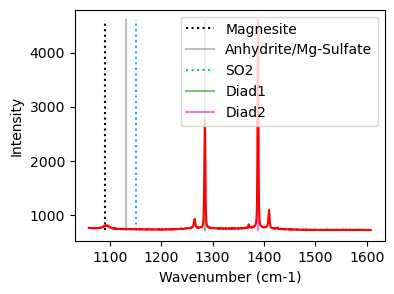

In [32]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [33]:
model_name='Pearson4Model'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [34]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='Pearson4Model', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220), upper_bck_diad1=(1330, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=2012.4019389914029, HB_prom=194.98965924422248, x_range_baseline=30, y_range_baseline=1000, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,HB1_Cent,HB1_Area,HB1_Sigma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF
0,1284.806183,1284.904538,0.016553,5653.631706,1.889258,0,1264.682796,5846.593239,1.045175,2032.027956,5.880235,0,2.376052,Flagged Warnings:,1.039244,1.067524,0.093246,0.001169


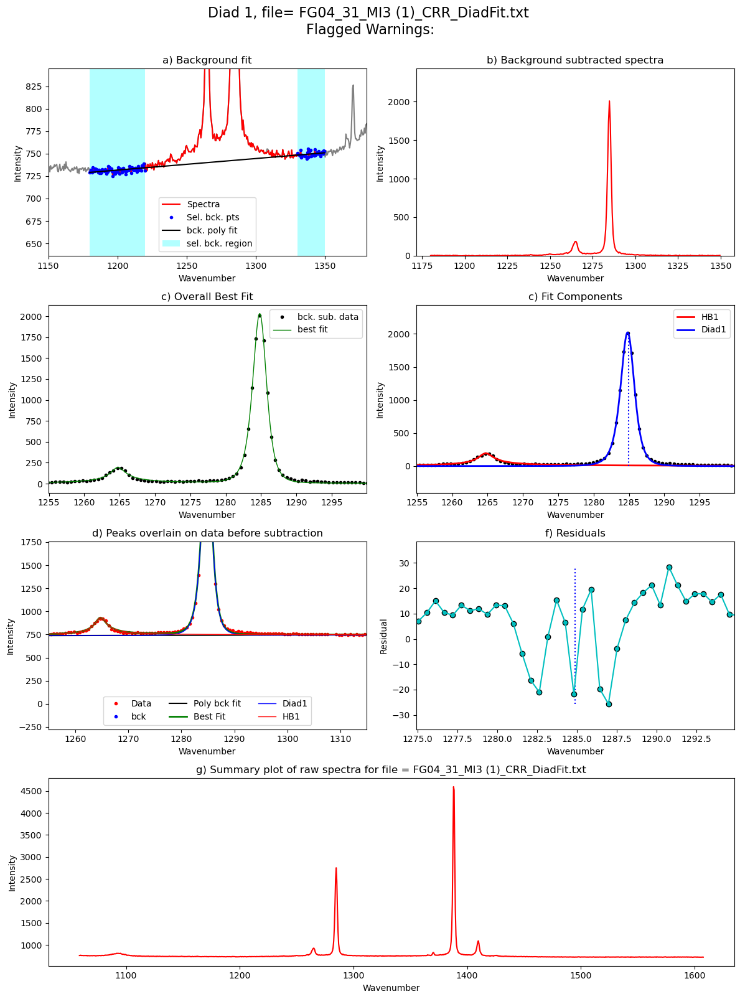

In [35]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [36]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [43]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=1,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3,
    lower_bck_diad2=(1310, 1350), diad_sigma=1.5,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='Pearson4Model', fit_peaks=3, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1340), upper_bck_diad2=(1440, 1470), fit_gauss=False, gauss_amp=1000, diad_sigma=1, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=7679.713502181589, HB_prom=349.98265041186073, x_range_baseline=30, y_range_baseline=1000, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False, C13_prom=132.50992972090705)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,HB2_Cent,HB2_Area,HB2_Sigma,C13_Cent,...,C13_Sigma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF
0,1387.525055,1387.545706,0.007355,20376.921024,1.257992,0,1409.883545,20928.737476,1.174538,1369.434492,...,0.572781,8324.552303,15.933426,0,1.912322,Flagged Warnings:,1.007005,1.001236,0.013396,0.00023


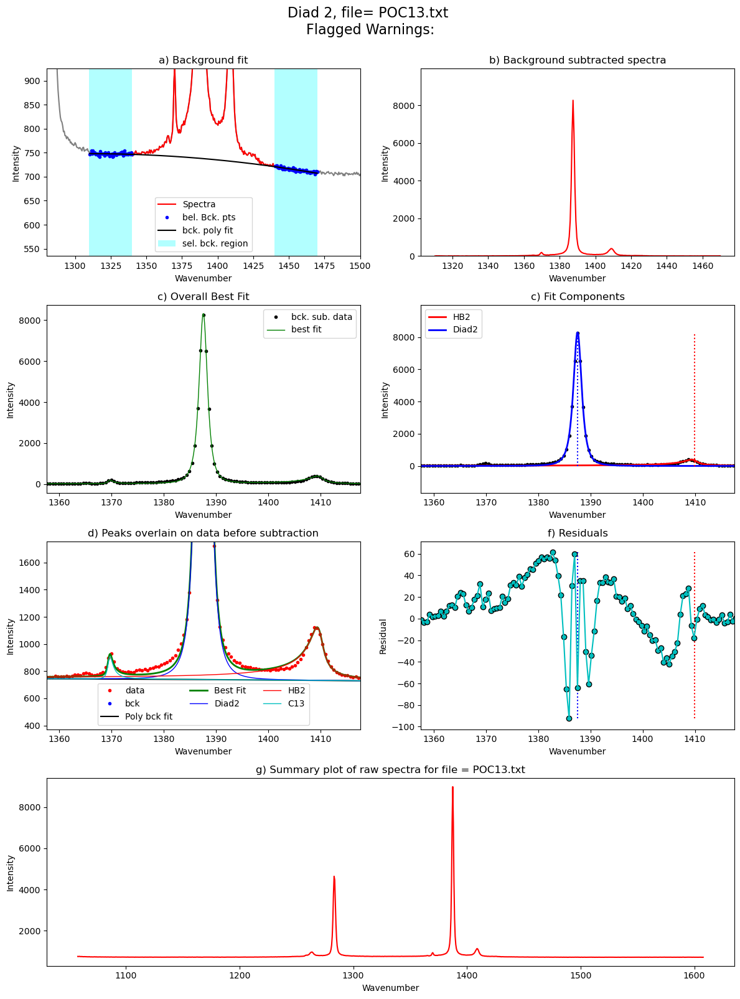

In [47]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[6], filetype=filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

In [45]:
Diad2_fit


,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,HB2_Cent,HB2_Area,HB2_Sigma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF
0,1387.238116,1387.250666,0.009025,19639.430085,1.224672,0,1410.048879,20740.638248,1.45989,7804.087463,18.031194,0,1.927175,Flagged Warnings:,1.013793,1.017094,0.026582,0.000247


## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/40 [00:00<?, ?it/s]

Processing file: FG04_31_MI3 (1)_CRR_DiadFit.txt
refit attempt 1


  2%|▎         | 1/40 [00:02<01:45,  2.70s/it]

Processing file: FG04_31_MI4 (1).txt
refit attempt 1


  5%|▌         | 2/40 [00:05<01:53,  2.99s/it]

Processing file: POC1.txt


  8%|▊         | 3/40 [00:13<03:05,  5.01s/it]

Processing file: POC10.txt
refit attempt 1


 10%|█         | 4/40 [00:16<02:32,  4.23s/it]

Processing file: POC11.txt


 12%|█▎        | 5/40 [00:19<02:16,  3.91s/it]

Processing file: POC12_CRR_DiadFit.txt
refit attempt 1


 15%|█▌        | 6/40 [00:22<02:01,  3.56s/it]

Processing file: POC13.txt


 18%|█▊        | 7/40 [00:26<01:59,  3.61s/it]

Processing file: POC14.txt


 20%|██        | 8/40 [00:31<02:15,  4.22s/it]

Processing file: POC15.txt


 22%|██▎       | 9/40 [00:36<02:11,  4.25s/it]

Processing file: POC16.txt


 25%|██▌       | 10/40 [00:40<02:10,  4.34s/it]

Processing file: POC17.txt


c:\users\penny\box\berkeley_new\diadfit_outer\src\DiadFit\diads.py:3008: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))
 28%|██▊       | 11/40 [00:51<03:03,  6.34s/it]

Processing file: POC18.txt


 30%|███       | 12/40 [00:55<02:40,  5.72s/it]

Processing file: POC19.txt


 32%|███▎      | 13/40 [01:16<04:37, 10.29s/it]

Processing file: POC2.txt


 35%|███▌      | 14/40 [01:44<06:44, 15.56s/it]

Processing file: POC20.txt
refit attempt 1


 38%|███▊      | 15/40 [01:47<04:51, 11.66s/it]

Processing file: POC21.txt
refit attempt 1


 40%|████      | 16/40 [01:50<03:37,  9.07s/it]

Processing file: POC22_CRR_DiadFit.txt
refit attempt 1


 42%|████▎     | 17/40 [01:52<02:43,  7.13s/it]

Processing file: POC23.txt
refit attempt 1


 45%|████▌     | 18/40 [01:55<02:08,  5.85s/it]

Processing file: POC24.txt


 48%|████▊     | 19/40 [01:58<01:43,  4.94s/it]

Processing file: POC25_CRR_DiadFit.txt


 50%|█████     | 20/40 [02:21<03:26, 10.35s/it]

Processing file: POC26.txt
refit attempt 1


 52%|█████▎    | 21/40 [02:24<02:35,  8.18s/it]

Processing file: POC27_CRR_DiadFit.txt
refit attempt 1


 55%|█████▌    | 22/40 [02:27<01:57,  6.55s/it]

Processing file: POC28.txt
refit attempt 1


 57%|█████▊    | 23/40 [02:30<01:32,  5.43s/it]

Processing file: POC29.txt
refit attempt 1


 60%|██████    | 24/40 [02:32<01:14,  4.65s/it]

Processing file: POC3.txt
refit attempt 1


 62%|██████▎   | 25/40 [02:38<01:15,  5.06s/it]

Processing file: POC30.txt


 65%|██████▌   | 26/40 [02:47<01:26,  6.15s/it]

Processing file: POC31.txt
refit attempt 1


 68%|██████▊   | 27/40 [02:52<01:17,  5.92s/it]

Processing file: POC32.txt
refit attempt 1


 70%|███████   | 28/40 [02:59<01:11,  5.97s/it]

Processing file: POC33.txt
refit attempt 1


 72%|███████▎  | 29/40 [03:04<01:03,  5.77s/it]

Processing file: POC34.txt
refit attempt 1


 75%|███████▌  | 30/40 [03:09<00:55,  5.53s/it]

Processing file: POC35.txt
refit attempt 1


 78%|███████▊  | 31/40 [03:14<00:48,  5.35s/it]

Processing file: POC36_CRR_DiadFit.txt
refit attempt 1


 80%|████████  | 32/40 [03:19<00:42,  5.27s/it]

Processing file: POC37.txt
refit attempt 1


 82%|████████▎ | 33/40 [03:24<00:36,  5.21s/it]

Processing file: POC38_CRR_DiadFit.txt
refit attempt 1


 85%|████████▌ | 34/40 [03:30<00:32,  5.46s/it]

Processing file: POC4_CRR_DiadFit.txt


 88%|████████▊ | 35/40 [03:40<00:34,  6.90s/it]

Processing file: POC5.txt


 90%|█████████ | 36/40 [04:28<01:16, 19.13s/it]

Processing file: POC6_CRR_DiadFit.txt


 92%|█████████▎| 37/40 [04:39<00:50, 16.83s/it]

Processing file: POC7_CRR_DiadFit.txt


 95%|█████████▌| 38/40 [04:49<00:29, 14.65s/it]

Processing file: POC8.txt
refit attempt 1


 98%|█████████▊| 39/40 [04:56<00:12, 12.54s/it]

Processing file: POC9.txt


100%|██████████| 40/40 [05:03<00:00,  7.60s/it]


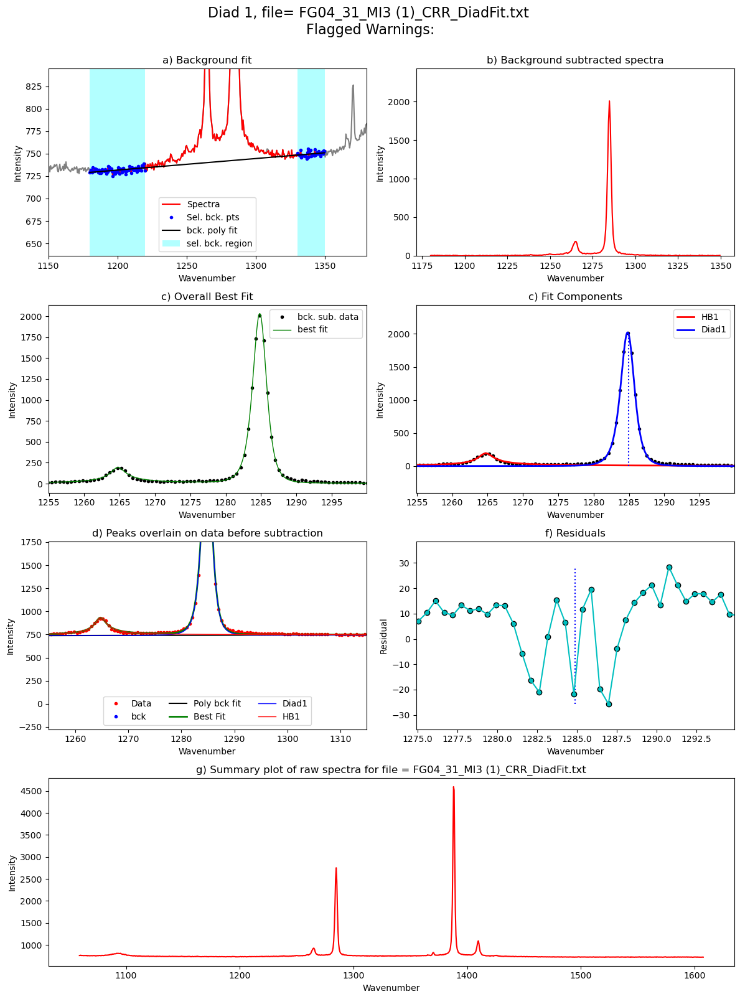

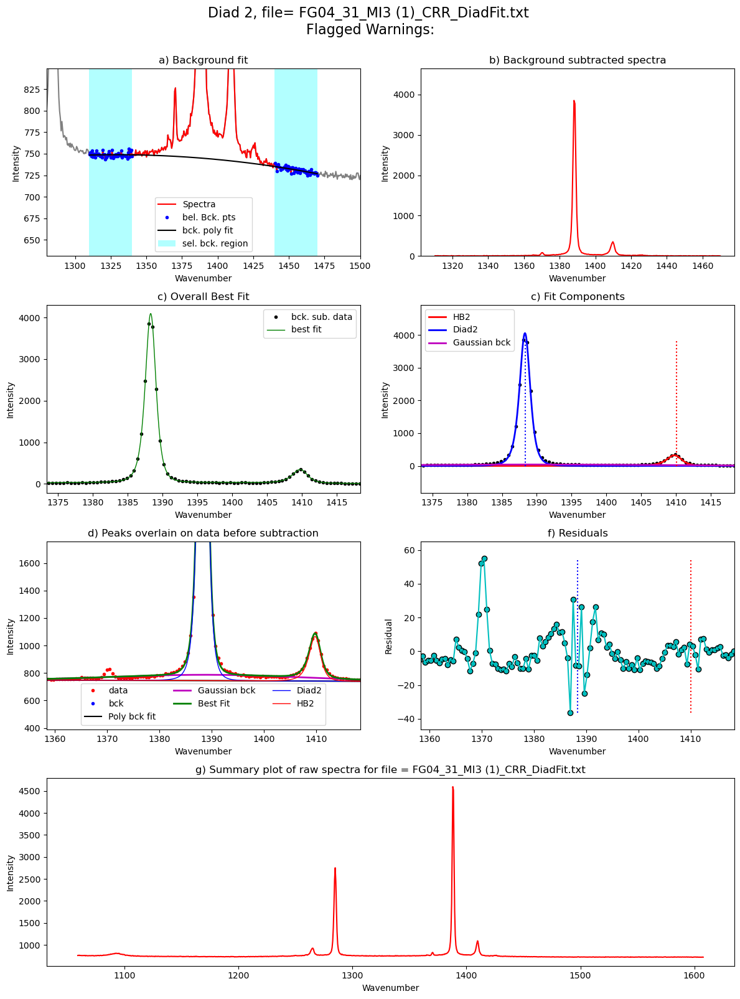

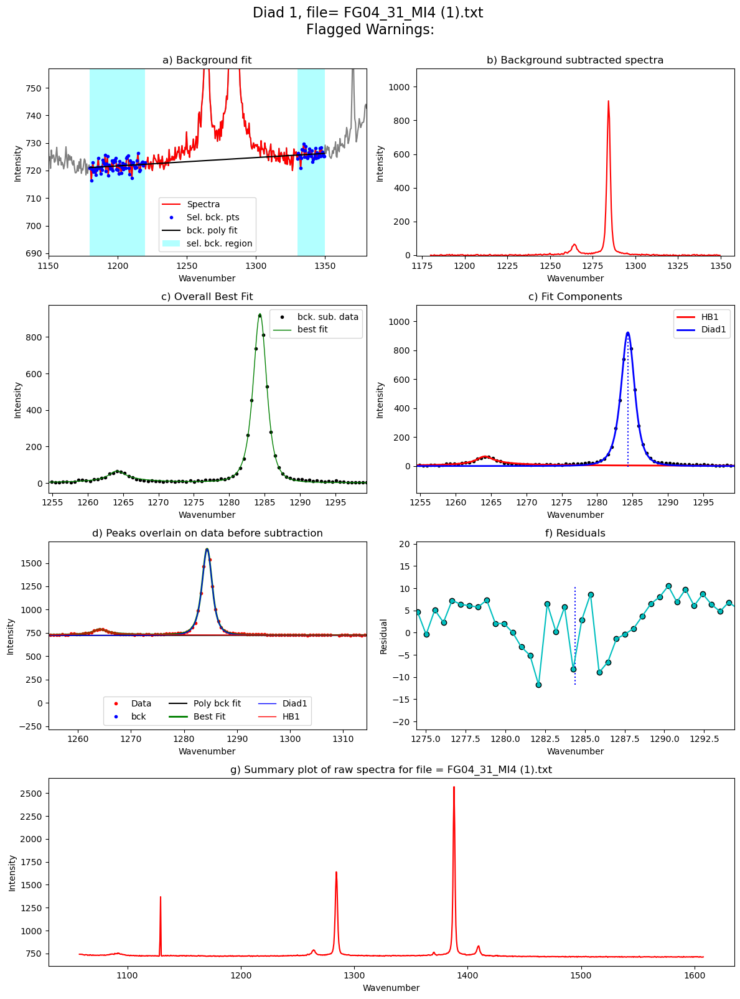

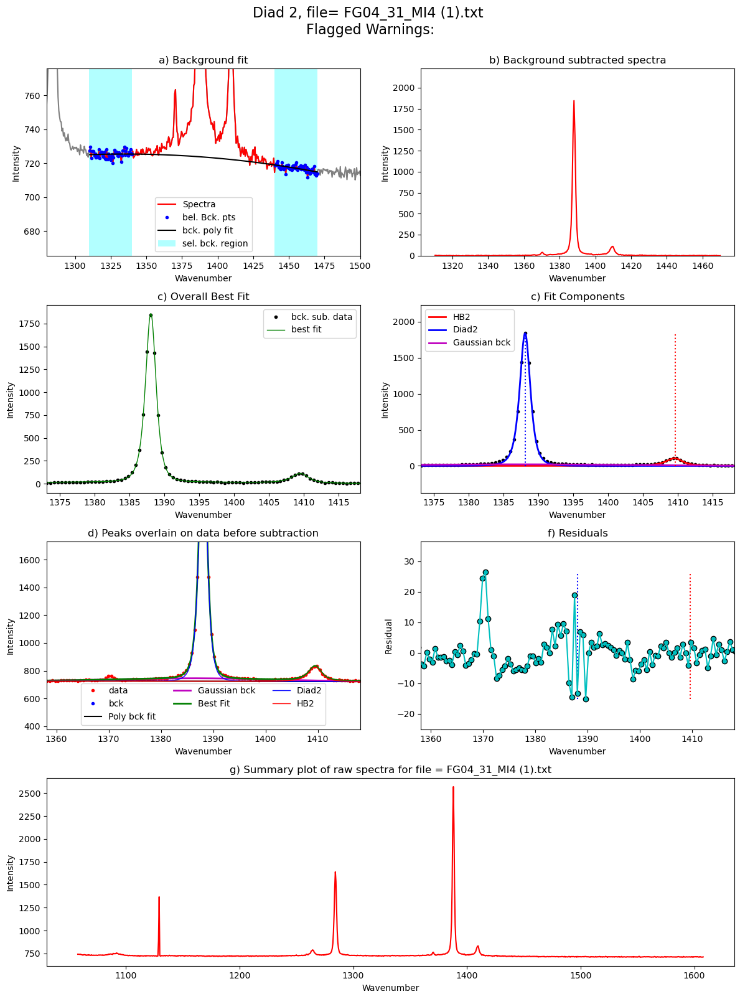

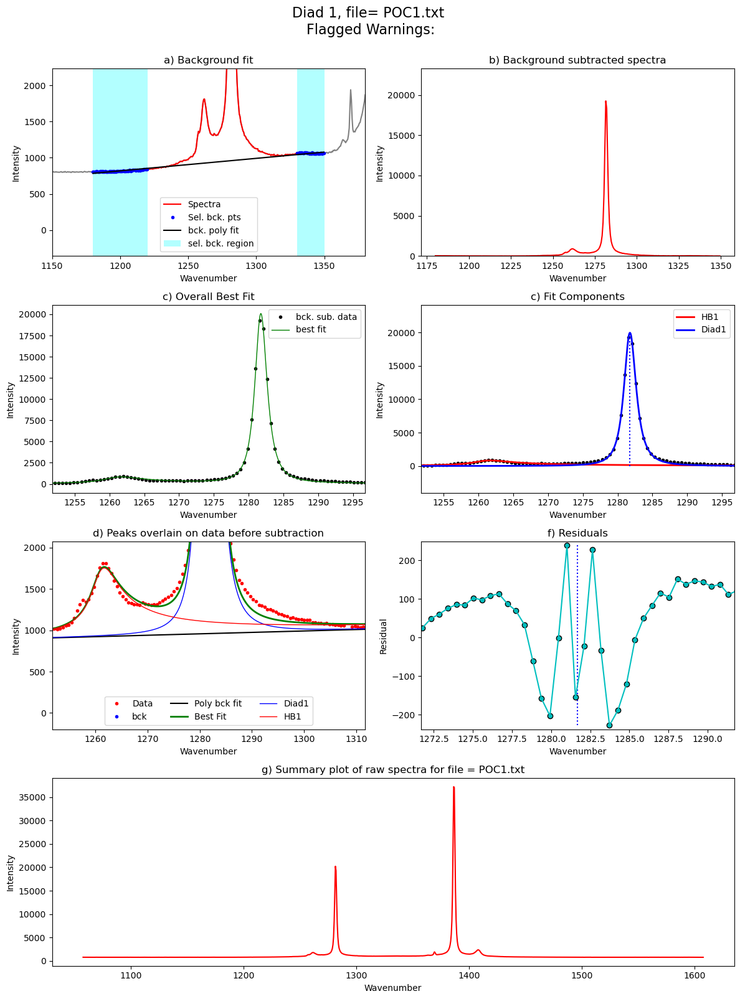

...

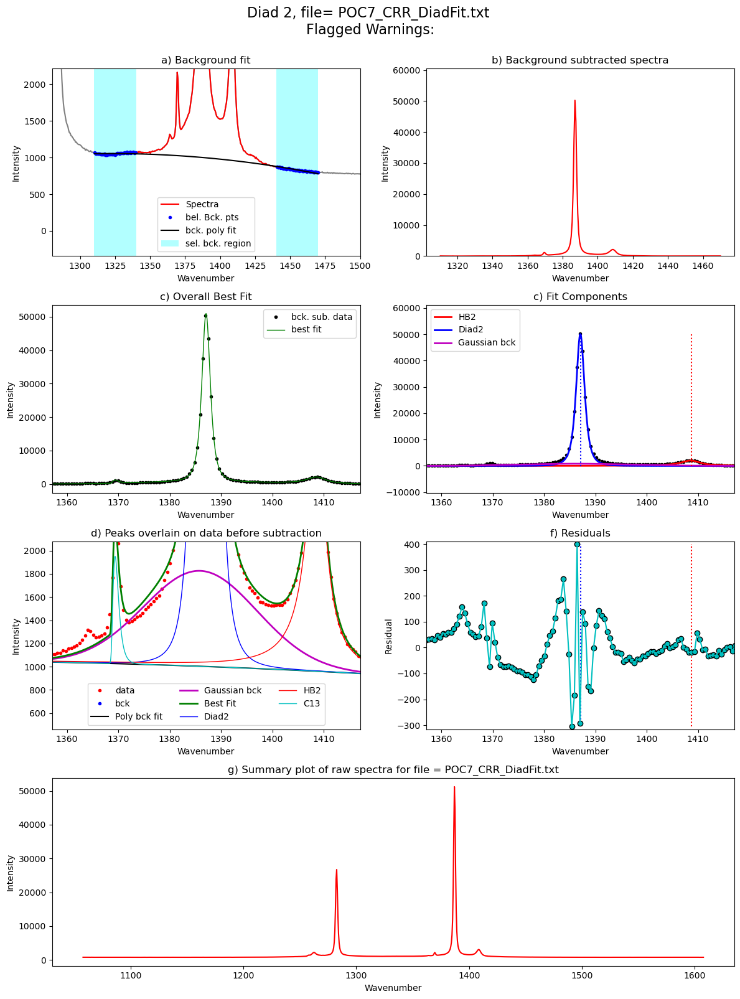

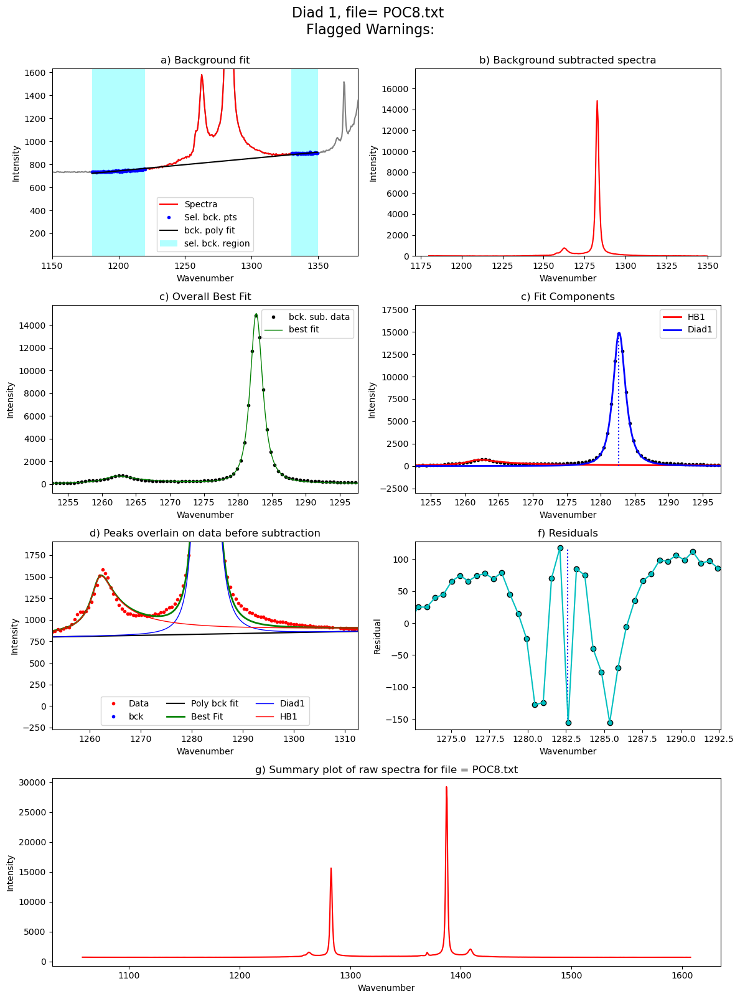

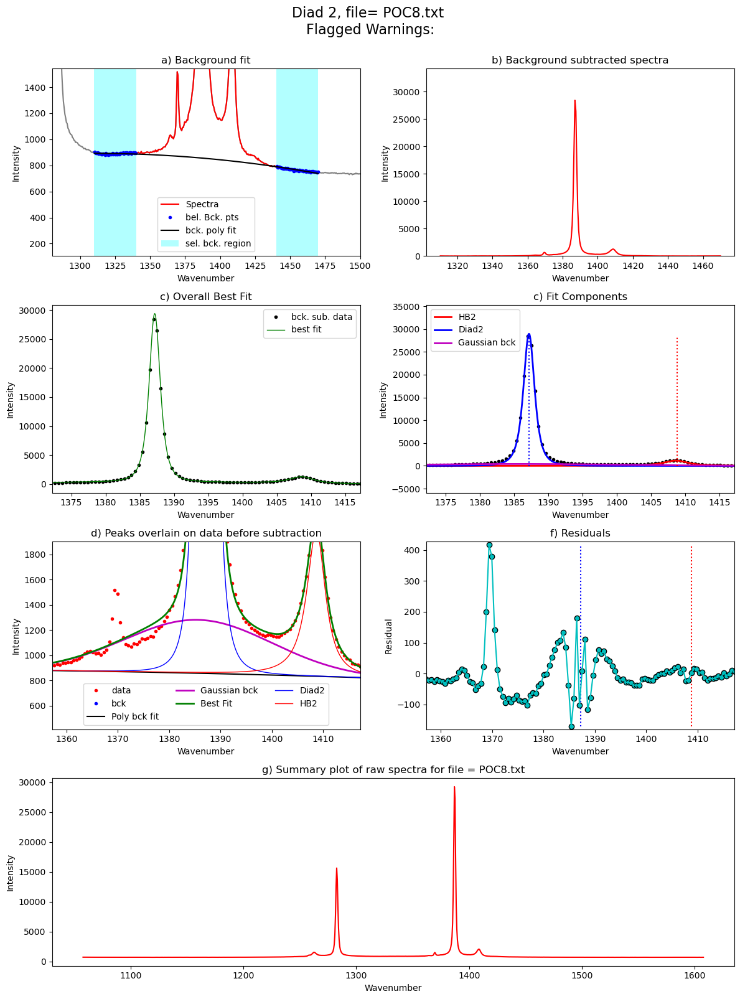

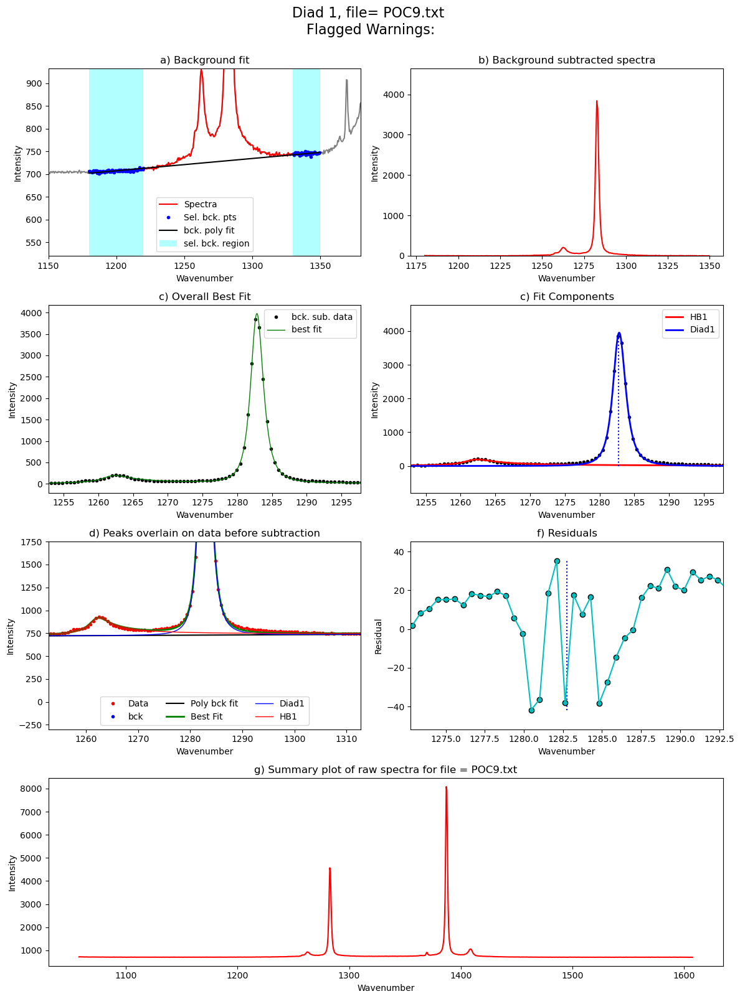

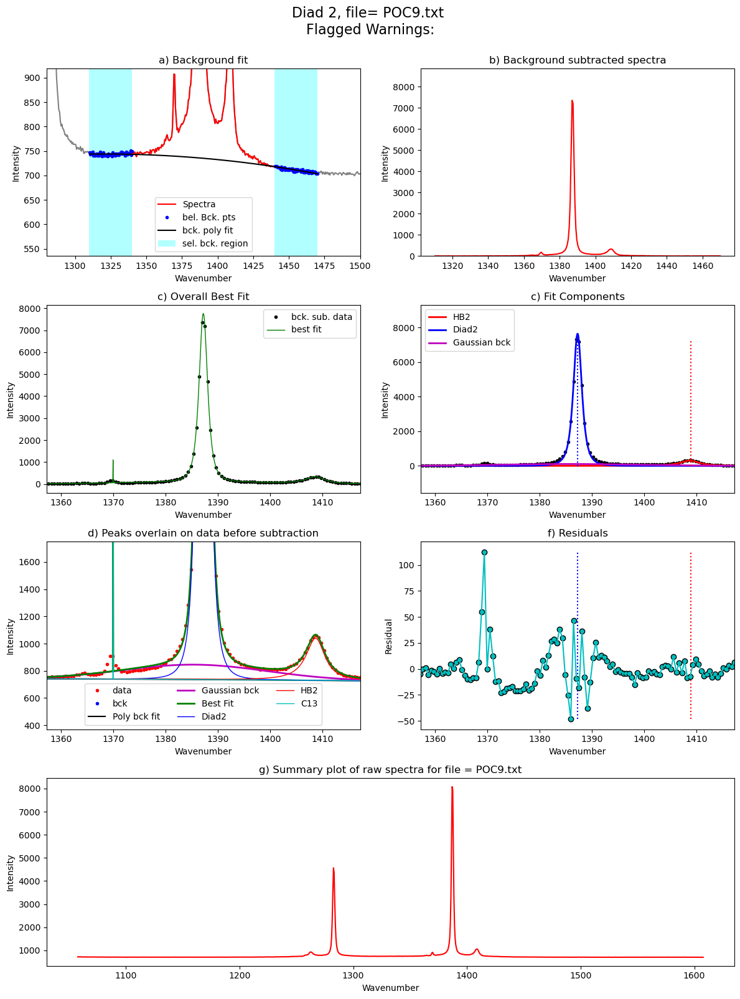

In [39]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [40]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads_P4_nogauss.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads_P4_nogauss.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads_P4_nogauss.xlsx', index=False)

In [41]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Gauss_Area,Diad1_Gauss_Sigma,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF
0,FG04_31_MI3 (1)_CRR_DiadFit,103.472859,0.018487,1284.806183,0.016553,2032.027956,1284.904538,5653.631706,1.889258,5.880235,...,NaN,NaN,1.039244,1.067524,0.093246,0.001169,1.027829,1.036486,0.051380,0.000451
1,FG04_31_MI4 (1),103.704509,0.016368,1284.353037,0.013980,928.366077,1284.402589,2572.393160,1.674354,2.666612,...,NaN,NaN,1.000000,1.057359,0.000000,0.002455,1.007407,1.006667,0.013513,0.000981
2,POC1,105.010267,0.008975,1281.758748,0.008208,20096.528980,1281.696694,57738.951150,1.239802,48.480392,...,NaN,NaN,1.065916,1.079096,0.135144,0.000102,1.038017,1.036952,0.076619,0.000053
3,POC10,104.422075,0.011503,1282.989433,0.009577,3868.210525,1282.913279,11029.927259,1.477130,8.823296,...,NaN,NaN,1.008929,1.032051,0.019327,0.000560,1.042179,1.027295,0.081146,0.000251
4,POC11,104.406177,0.012234,1283.109986,0.011670,3203.344811,1283.014331,9218.658321,1.596128,8.058383,...,NaN,NaN,1.024818,1.050847,0.055101,0.000693,1.042857,1.036432,0.081803,0.000295
5,POC12_CRR_DiadFit,104.289580,0.013482,1283.297782,0.012060,4313.480466,1283.216928,12512.894485,1.665953,10.780716,...,NaN,NaN,1.056851,1.060797,0.129198,0.000527,1.007018,1.009950,0.013407,0.000218
6,POC13,104.237360,0.013469,1283.365922,0.012097,4039.525271,1283.301568,11821.763989,1.674783,9.908727,...,NaN,NaN,1.028571,1.040165,0.065756,0.000570,1.007005,1.001236,0.013407,0.000231
7,POC14,104.215806,0.012764,1283.424440,0.011933,3746.108985,1283.360186,11064.406157,1.704528,9.201958,...,NaN,NaN,1.025388,1.032454,0.059130,0.000622,1.017668,1.015000,0.033747,0.000247
8,POC15,104.176907,0.013088,1283.511165,0.012108,3510.584199,1283.448512,10357.031306,1.716228,8.679364,...,NaN,NaN,1.005563,1.012072,0.012979,0.000665,1.021164,1.015056,0.040458,0.000266
9,POC16,104.133153,0.015214,1283.602847,0.013409,3218.273245,1283.538694,9501.398527,1.798479,8.332888,...,NaN,NaN,1.012414,1.031219,0.029343,0.000734,1.019332,1.020075,0.037041,0.000290


### This plays a sound - if you have a tendency  to procrastinate while notebooks are running

In [42]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()